# The Experiment of CS577 Project


Topic - **Explore the Application of Diffusion Model in Video Content Creation**

The complete experimental process design is illustrated in the following figure:
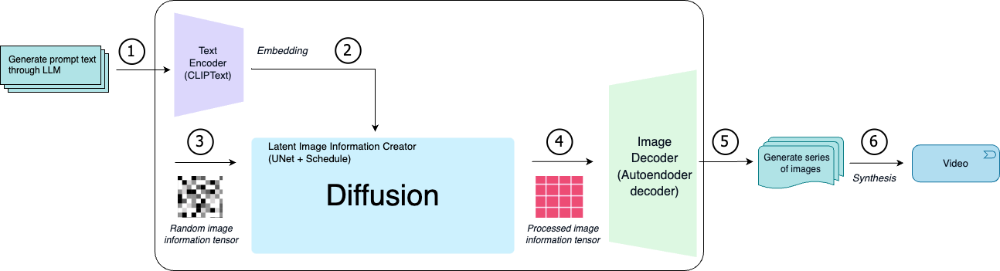

First, determine the video topic that needs to be produced. Utilize modern large-scale language models to refine scenes and generate corresponding prompt words. Input these prompts into the Stable Diffusion Model, generate a series of pictures, and finally use ffmpeg to synthesize them into videos

## 1. Use `ChatGPT-3.5` to refine the video scene


Use ChatGPT-3.5 to refine the video scenes
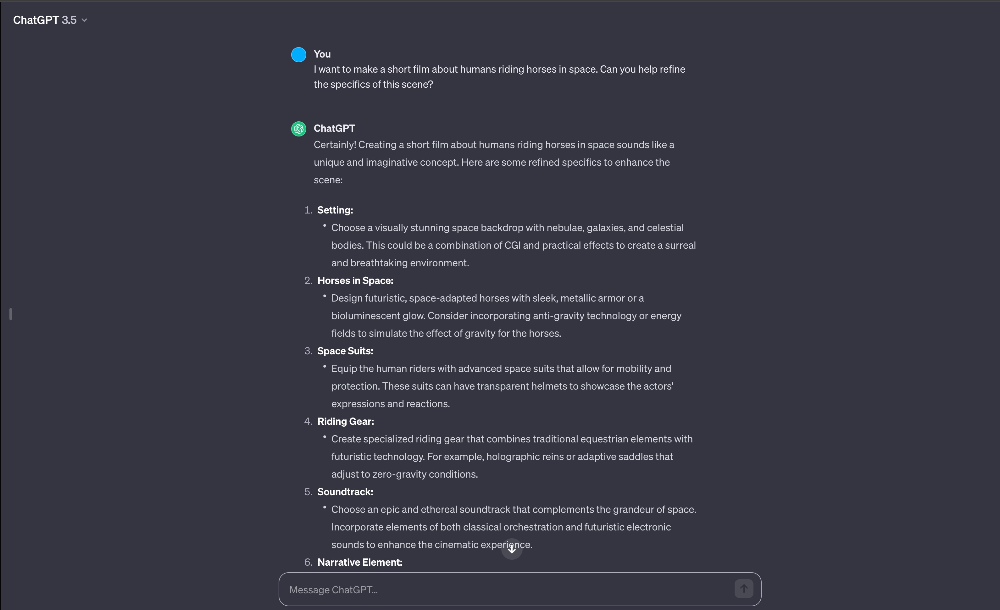

Then summarize and output the prompt words
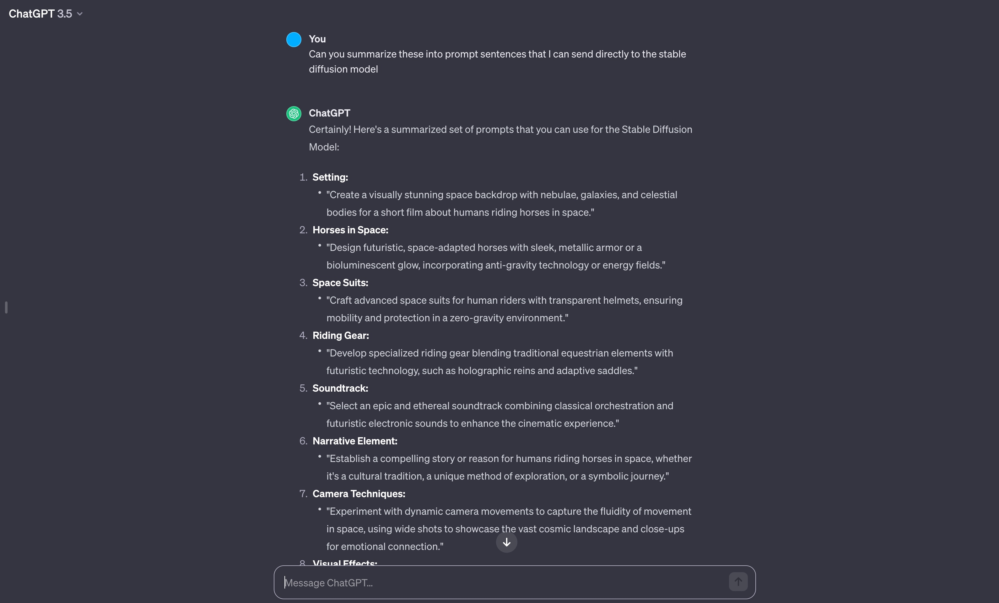

## 2. Use `StableDiffusionPipeline` to generate a series of pictures


### Setup


First, please make sure you are using a GPU runtime to run this notebook, so inference is much faster. If the following command fails, use the `Runtime` menu above and select `Change runtime type`.

In [ ]:
!nvidia-smi

Fri Dec  1 10:36:21 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   70C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Next, you should install `diffusers` as well `scipy`, `ftfy` and `transformers`. `accelerate` is used to achieve much faster loading.

In [ ]:
!pip install diffusers==0.11.1
!pip install transformers scipy ftfy accelerate

### Stable Diffusion Pipeline



`StableDiffusionPipeline` is an end-to-end inference pipeline that you can use to generate images from text with just a few lines of code.

First, we load the pre-trained weights of all components of the model. In this notebook we use Stable Diffusion version 1.4 ([CompVis/stable-diffusion-v1-4](https://huggingface.co/CompVis/stable-diffusion-v1-4))

In addition to the model id [CompVis/stable-diffusion-v1-4](https://huggingface.co/CompVis/stable-diffusion-v1-4), we're also passing a specific `revision` and `torch_dtype` to the `from_pretrained` method.

We want to ensure that every free Google Colab can run Stable Diffusion, hence we're loading the weights from the half-precision branch [`fp16`](https://huggingface.co/CompVis/stable-diffusion-v1-4/tree/fp16) and also tell `diffusers` to expect the weights in float16 precision by passing `torch_dtype=torch.float16`.

In [ ]:
import torch
from diffusers import StableDiffusionPipeline

pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", torch_dtype=torch.float16)

Next, let's move the pipeline to GPU to have faster inference.

In [ ]:
pipe = pipe.to("cuda")

And we are ready to generate images:

  0%|          | 0/50 [00:00<?, ?it/s]

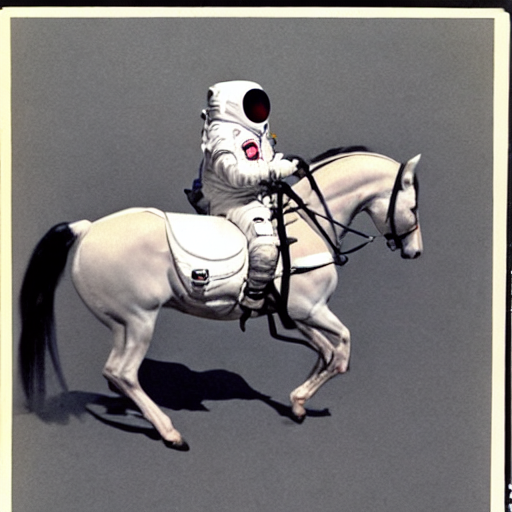

In [ ]:
prompt = "a photograph of an astronaut riding a horse"
image = pipe(prompt).images[0]  # image here is in [PIL format](https://pillow.readthedocs.io/en/stable/)

# Now to display an image you can either save it such as:
image.save(f"astronaut_rides_horse.png")

# or if you're in a google colab you can directly display it with
image

Running the above cell multiple times will give you a different image every time. If you want deterministic output you can pass a random seed to the pipeline. Every time you use the same seed you'll have the same image result.

  0%|          | 0/50 [00:00<?, ?it/s]

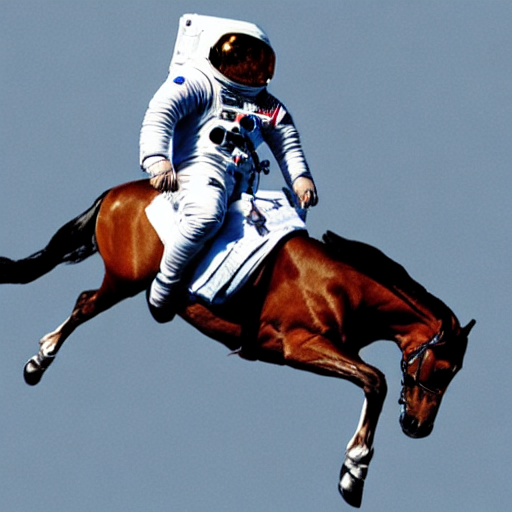

In [ ]:
import torch

generator = torch.Generator("cuda").manual_seed(1024)

image = pipe(prompt, generator=generator).images[0]

image

You can change the number of inference steps using the `num_inference_steps` argument. In general, results are better the more steps you use. Stable Diffusion, being one of the latest models, works great with a relatively small number of steps, so we recommend to use the default of `50`. If you want faster results you can use a smaller number.

The following cell uses the same seed as before, but with fewer steps. Note how some details, such as the horse's head or the helmet, are less defin realistic and less defined than in the previous image:

  0%|          | 0/15 [00:00<?, ?it/s]

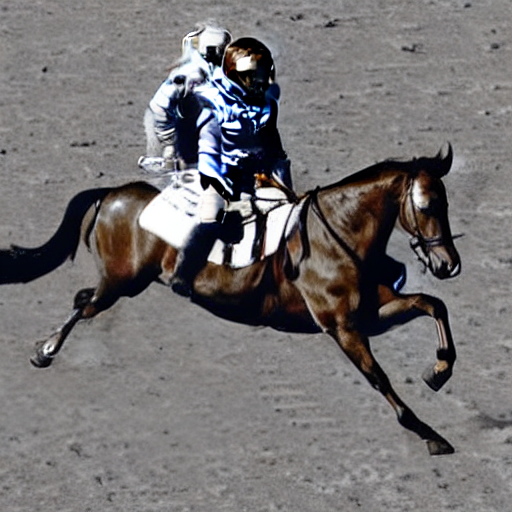

In [ ]:
import torch

generator = torch.Generator("cuda").manual_seed(1024)

image = pipe(prompt, num_inference_steps=15, generator=generator).images[0]

image

To generate multiple images for the same prompt, we simply use a list with the same prompt repeated several times. We'll send the list to the pipeline instead of the string we used before.



Let's first write a helper function to display a grid of images. Just run the following cell to create the `image_grid` function, or disclose the code if you are interested in how it's done.

In [ ]:
from PIL import Image
import os

def image_grid_gap_white(imgs, rows, cols, gap=5, save_img=False, img_path="./"):
    assert len(imgs) == rows * cols

    w, h = imgs[0].size
    grid_w = cols * (w + gap) - gap
    grid_h = rows * (h + gap) - gap
    grid = Image.new('RGB', size=(grid_w, grid_h), color=(255, 255, 255)) # Create a white background

    for i, img in enumerate(imgs):
        x = (i % cols) * (w + gap)
        y = (i // cols) * (h + gap)
        grid.paste(img, box=(x, y))

        if save_img:
            if not os.path.exists(img_path):
                os.makedirs(img_path)
            img.save(f"{img_path}/sd_{i:02d}.png")
    return grid

Now, we can generate a grid image once having run the pipeline with a list of 3 prompts.

  0%|          | 0/50 [00:00<?, ?it/s]

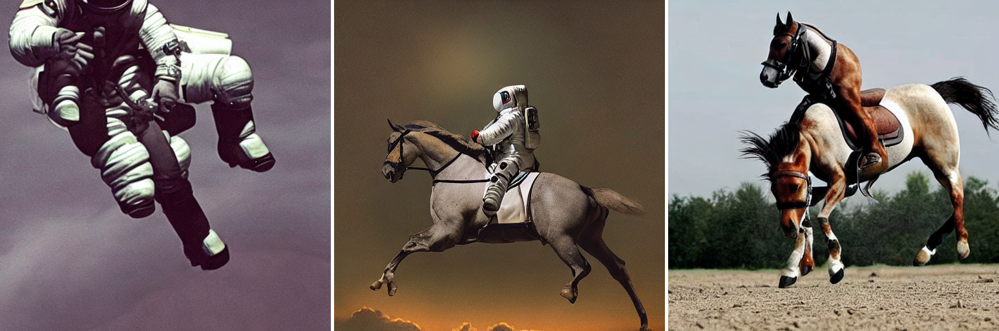

In [ ]:
num_images = 3
prompt = ["a photograph of an astronaut riding a horse"] * num_images

images = pipe(prompt).images

grid = image_grid_gap_white(images, rows=1, cols=3, gap=5, save_img=True, img_path='./output')
grid

## 3. Generate a sires of pictures


### **Experiment 1** - Prompt words: "a photograph of an astronaut riding a horse"

In [ ]:
num_cols = 7
num_rows = 8

prompt = ["a photograph of an astronaut riding a horse"] * num_cols

all_images = []
for i in range(num_rows):
  images = pipe(prompt).images
  all_images.extend(images)


grid = image_grid_gap_white(all_images, rows=num_rows, cols=num_cols, gap=5, save_img=True, img_path='./astronaut')
grid

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Colab didn't show the picture, so paste the results here:
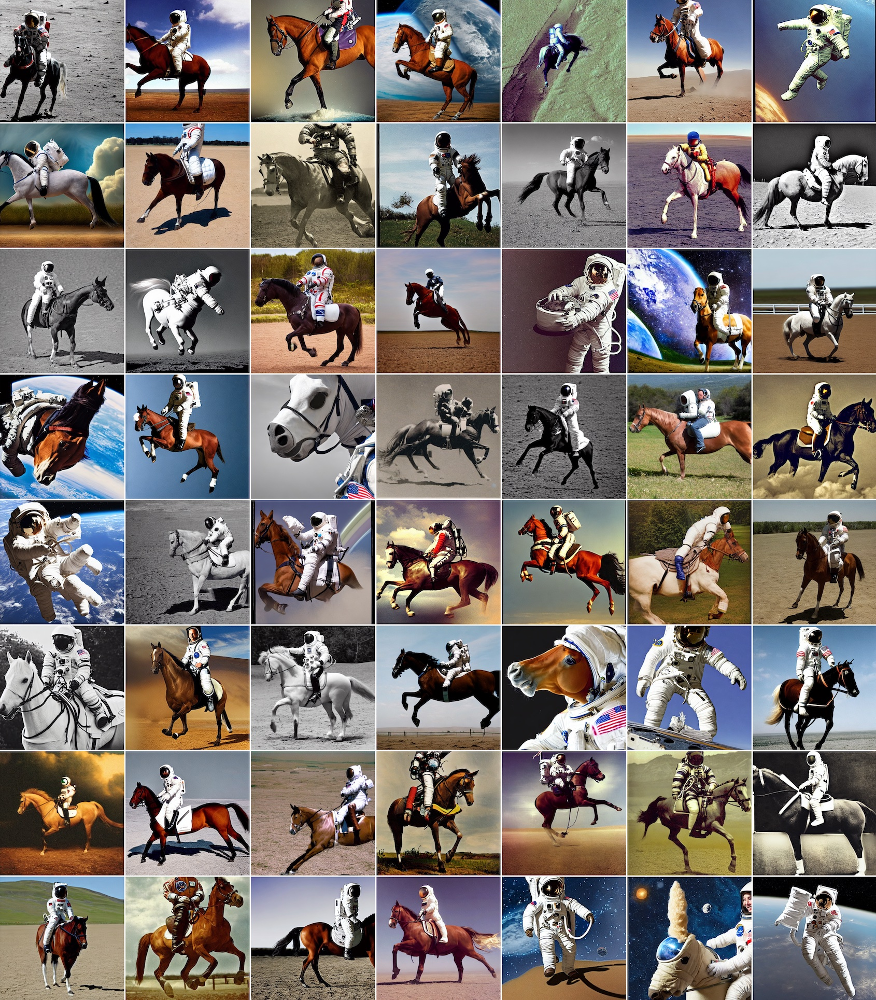

### **Experiment 2** - Prompt words: "Many flowers growing in the riverside park"

In [ ]:
num_cols = 7
num_rows = 8

prompt = ["Many flowers growing in the riverside park"] * num_cols

all_images = []
for i in range(num_rows):
  images = pipe(prompt).images
  all_images.extend(images)


grid = image_grid_gap_white(all_images, rows=num_rows, cols=num_cols, gap=5, save_img=True, img_path='./flowers')
grid

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Colab didn't show the picture, so paste the results here:
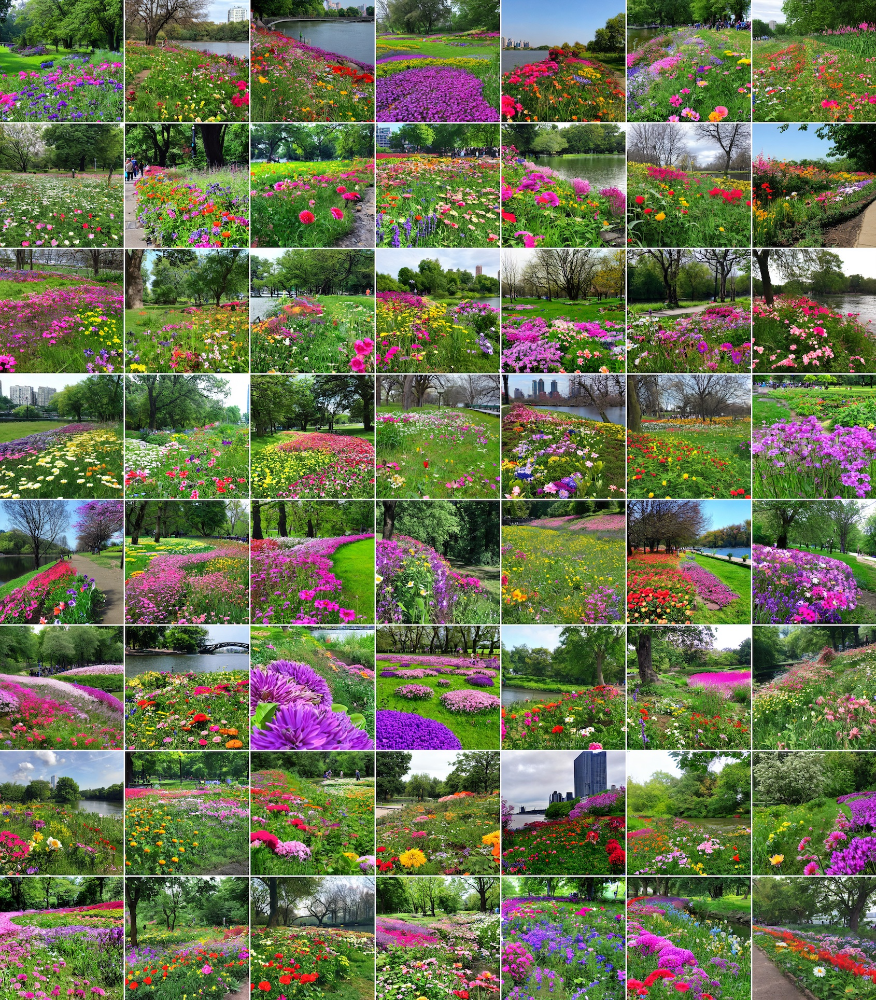

### **Experiment 3** - Prompt words: "A very exciting and fun speed racing game"

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

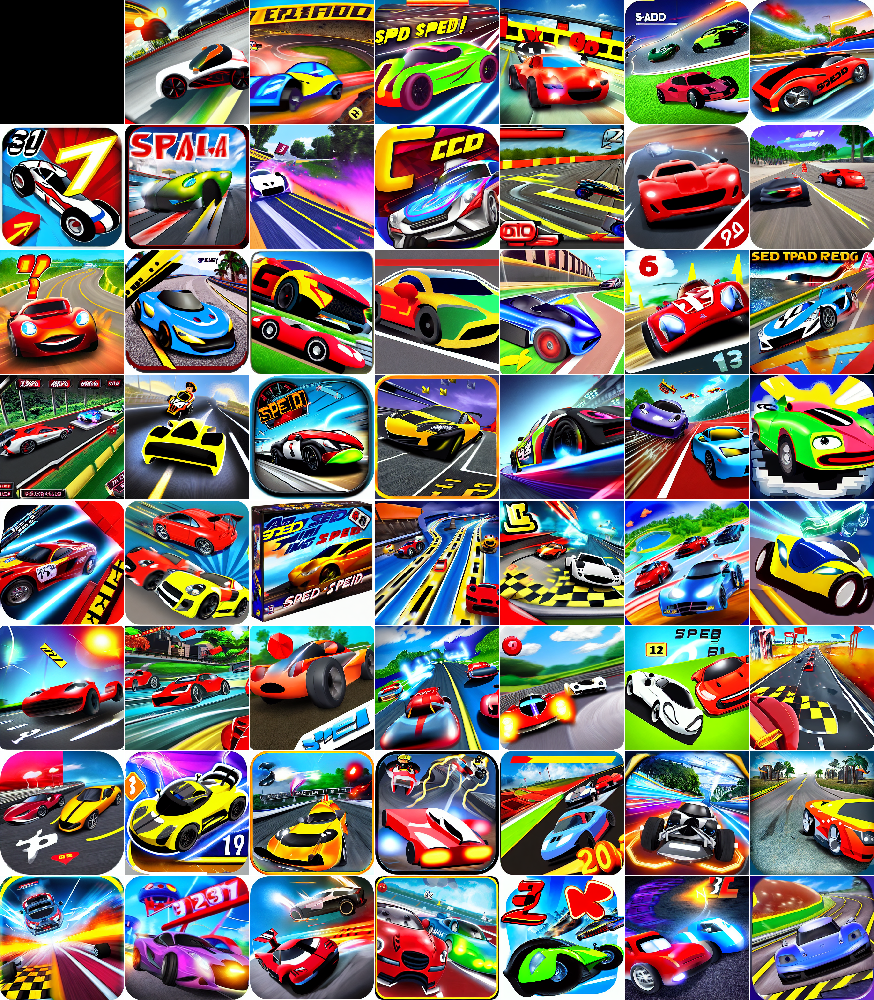

In [ ]:
num_cols = 7
num_rows = 8

prompt = ["A very exciting and fun speed racing game"] * num_cols

all_images = []
for i in range(num_rows):
  images = pipe(prompt).images
  all_images.extend(images)


grid = image_grid_gap_white(all_images, rows=num_rows, cols=num_cols, gap=5, save_img=True, img_path='./game')
grid

## 4. Use `FFMPEG` to synthetic video

Use ffmpeg to synthesize videos, and we can also import some background music to make the entire video more realistic and vivid.

### **Experiment 1** - Synthesize the pictures generated in above `Experiment 1` into video

In [ ]:
!ffmpeg -ss 10 -i '/content/time-technology-11257.mp3' -t 8 '/content/time-technology-11257_bgm.mp3'
!ffmpeg -r 7 -f image2 -s 512x512 -i /content/astronaut/sd_%02d.png -i './time-technology-11257_bgm.mp3' -vcodec libx264 -crf 25 -pix_fmt yuv420p astronaut.mp4

In [40]:
!ls

astronaut	       flower-146718.mp3  game	       stylish-rock-beat-trailer-116346_bgm.mp3
astronaut.mp4	       flowers		  game.mp4     stylish-rock-beat-trailer-116346.mp3
astronaut.png	       flowers.mp4	  game.png     time-technology-11257_bgm.mp3
astronaut.zip	       flowers.png	  game.zip     time-technology-11257.mp3
flower-146718_bgm.mp3  flowers.zip	  sample_data


### **Experiment 2** - Synthesize the pictures generated in above `Experiment 2` into video

In [ ]:
!ffmpeg -ss 10 -i '/content/flower-146718.mp3' -t 8 '/content/flower-146718_bgm.mp3'
!ffmpeg -r 7 -f image2 -s 512x512 -i /content/flowers/sd_%02d.png -i './flower-146718_bgm.mp3' -vcodec libx264 -crf 25 -pix_fmt yuv420p flowers.mp4

In [41]:
!ls

astronaut	       flower-146718.mp3  game	       stylish-rock-beat-trailer-116346_bgm.mp3
astronaut.mp4	       flowers		  game.mp4     stylish-rock-beat-trailer-116346.mp3
astronaut.png	       flowers.mp4	  game.png     time-technology-11257_bgm.mp3
astronaut.zip	       flowers.png	  game.zip     time-technology-11257.mp3
flower-146718_bgm.mp3  flowers.zip	  sample_data


### **Experiment 3** - Synthesize the pictures generated in above`Experiment 3` into video

In [ ]:
!ffmpeg -ss 10 -i '/content/stylish-rock-beat-trailer-116346.mp3' -t 8 '/content/stylish-rock-beat-trailer-116346_bgm.mp3'
!ffmpeg -r 7 -f image2 -s 512x512 -i /content/game/sd_%02d.png -i './stylish-rock-beat-trailer-116346_bgm.mp3' -vcodec libx264 -crf 25 -pix_fmt yuv420p game.mp4

In [42]:
!ls

astronaut	       flower-146718.mp3  game	       stylish-rock-beat-trailer-116346_bgm.mp3
astronaut.mp4	       flowers		  game.mp4     stylish-rock-beat-trailer-116346.mp3
astronaut.png	       flowers.mp4	  game.png     time-technology-11257_bgm.mp3
astronaut.zip	       flowers.png	  game.zip     time-technology-11257.mp3
flower-146718_bgm.mp3  flowers.zip	  sample_data


## References:

- [stable_diffusion](https://colab.research.google.com/github/huggingface/notebooks/blob/main/diffusers/stable_diffusion.ipynb)
- [Diffusers: State-of-the-art diffusion models for image and audio generation in PyTorch](https://github.com/huggingface/diffusers)

## Music sources:

- [Time Technology - Coma-Media](https://pixabay.com/music/upbeat-time-technology-11257/)
- [Flower - Tuky_Music](https://pixabay.com/music/acoustic-group-flower-146718/)
- [Stylish Rock Beat Trailer - ComaStudio](https://pixabay.com/music/beats-stylish-rock-beat-trailer-116346/)